<img src="https://previews.123rf.com/images/trimulyani/trimulyani2002/trimulyani200201852/141090583-call-phone-icon-telephone-icon-vector-design-symbol.jpg" style="float: left; margin: 20px; height: 85px">

# 2 - Exploratory Data Analysis and Data Manipulation

<span style="font-size: 16px;">In this notebook, we will analyze and preprocess audio data to reduce its size without losing critical information. Our goal is to standardize the audio files, ensuring they have a consistent shape suitable for input into a neural network model.

### Importing libraries

In [20]:
from glob import glob
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import librosa
import librosa.display
import IPython

# set seed for reproducibility
seed = 42
np.random.seed(seed)

In [21]:
# listing all the audio files with wav format in subfolders of 'data' folder
files_path = glob('../data/*/*.wav')
files_path

['../data/happy/03-01-03-01-01-02-06.wav',
 '../data/happy/03-01-03-01-01-02-12.wav',
 '../data/happy/03-01-03-02-02-02-12.wav',
 '../data/happy/03-01-03-02-02-02-06.wav',
 '../data/happy/03-01-03-02-02-02-07.wav',
 '../data/happy/03-01-03-02-02-02-13.wav',
 '../data/happy/03-01-03-01-01-02-13.wav',
 '../data/happy/03-01-03-01-01-02-07.wav',
 '../data/happy/03-01-03-01-01-02-11.wav',
 '../data/happy/03-01-03-01-01-02-05.wav',
 '../data/happy/03-01-03-02-02-02-05.wav',
 '../data/happy/03-01-03-02-02-02-11.wav',
 '../data/happy/03-01-03-01-02-02-19.wav',
 '../data/happy/03-01-03-02-01-02-19.wav',
 '../data/happy/03-01-03-02-01-02-24.wav',
 '../data/happy/03-01-03-02-01-02-18.wav',
 '../data/happy/03-01-03-01-02-02-18.wav',
 '../data/happy/03-01-03-01-02-02-24.wav',
 '../data/happy/03-01-03-02-02-02-10.wav',
 '../data/happy/03-01-03-02-02-02-04.wav',
 '../data/happy/03-01-03-01-01-02-04.wav',
 '../data/happy/03-01-03-01-01-02-10.wav',
 '../data/happy/03-01-03-01-01-02-14.wav',
 '../data/h

## Loading data and extracting characteristics

<span style="font-size: 16px;"> Librosa is a widely used Python library for audio analysis and manipulation. In this section, we will use Librosa to load audio files and extract characteristics such as length and loudness. This data will help us select and analyze the audio files as we apply various preprocessing techniques throughout the notebook.

In [22]:
# reading and extracting characteristics of the files
files = []
lengths = []
seconds = []
labels = []
emotions = []
sample_rate = []
corrupted_files = []
len_trim = []
np_max = []
diff_percent = []

for file in files_path:
  try:
    # extracting filepath
    files.append(file)
    # loading audio using librosa
    y, sr = librosa.load(file, sr=None)
    # extracting numpy array length of the file
    lengths.append(len(y))
    # extracting how many seconds the file has
    seconds.append(len(y)/sr)
    # extracting sample rate to check if all audios have the same sample rate
    sample_rate.append(sr)
    # extracting the label as string and as integer
    labels.append(file.split('-')[-5])
    emotions.append(file.split('/')[2])
    # setting a threshold of 30 below reference to be considered as silence
    y_trimmed, _ = librosa.effects.trim(y, top_db = 20)
    #appending the trimmed audio
    len_trim.append(len(y_trimmed))
    # getting the highest amplitude of the file
    np_max.append(np.max(y))
    # getting the difference of numpy array length of trimmed and original audio
    diff_percent.append((len(y)-len(y_trimmed))/len(y))
  except:
    # checking if files could not be open with librosa
    corrupted_files.append(file)

In [23]:
print(f'Corrupted files: {len(corrupted_files)}')

Corrupted files: 0


In [24]:
# creating a dataset with those extracted features
files_details = pd.DataFrame([files, lengths, seconds, sample_rate, emotions, labels, len_trim, np_max, diff_percent]).T
files_details.columns = ['file', 'length', 'seconds', 'sample_rate', 'emotions', 'label', 'len_trim', 'max_amp', 'diff_percent']

In [25]:
files_details.head()

,file,length,seconds,sample_rate,emotions,label,len_trim,max_amp,diff_percent
0,../data/happy/03-01-03-01-01-02-06.wav,172973,3.603604,48000,happy,03,78336,0.081299,0.54712
1,../data/happy/03-01-03-01-01-02-12.wav,179379,3.737062,48000,happy,03,79872,0.082794,0.55473
2,../data/happy/03-01-03-02-02-02-12.wav,190590,3.970625,48000,happy,03,90624,0.445831,0.524508
3,../data/happy/03-01-03-02-02-02-06.wav,172972,3.603583,48000,happy,03,78848,0.354523,0.544157
4,../data/happy/03-01-03-02-02-02-07.wav,184184,3.837167,48000,happy,03,92672,0.265961,0.496851


In [26]:
files_details.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1439 entries, 0 to 1438
Data columns (total 9 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   file          1439 non-null   object
 1   length        1439 non-null   object
 2   seconds       1439 non-null   object
 3   sample_rate   1439 non-null   object
 4   emotions      1439 non-null   object
 5   label         1439 non-null   object
 6   len_trim      1439 non-null   object
 7   max_amp       1439 non-null   object
 8   diff_percent  1439 non-null   object
dtypes: object(9)
memory usage: 101.3+ KB


<span style="font-size: 16px;">The code was able to extract the info needed for all audios. One thing left to do is to transform to numeric all the features but the file path and emotion, so they can be filtered for the need to analyze changes in audios with different features.

In [27]:
files_details[['length', 'seconds', 'sample_rate', 'len_trim', 'max_amp', 'diff_percent']] = \
    files_details[['length', 'seconds', 'sample_rate', 'len_trim', 'max_amp', 'diff_percent']].apply(pd.to_numeric)

In [28]:
files_details.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
length,1439.0,177641.826963,16161.665643,140941.000000,166567.000000,176176.000000,185786.000000,253053.000000
seconds,1439.0,3.700871,0.336701,2.936271,3.470146,3.670333,3.870542,5.271937
sample_rate,1439.0,48000.000000,0.000000,48000.000000,48000.000000,48000.000000,48000.000000,48000.000000
len_trim,1439.0,80185.848506,16921.907508,38400.000000,69120.000000,77312.000000,88576.000000,160256.000000
max_amp,1439.0,0.173484,0.211700,0.004669,0.045975,0.094849,0.201477,0.999146
diff_percent,1439.0,0.551972,0.063856,0.241166,0.524442,0.561920,0.590925,0.757819


<span style="font-size: 16px;">Librosa loads audios as numpy time series arrays, whose absolute values represent the loudness of the audio.

<span style="font-size: 16px;">Sample rate is the number of data points per second the audio has, and we can see that all audios were loaded with a sample rate of 48000. Audios varied from 2.9 seconds to approximately 5.3 seconds. The feature ```diff_percent``` represents the percen 

In [29]:
# exporting the dataframe created as csv
files_details.to_csv('../csvs/files_details.csv')

## Playing some original audios

In [30]:
emotions = []
for emotion in glob('../data/*'):
    emotions.append(emotion.split('/')[2])
    
files = []    
for emotion in emotions:
    mask = files_details['emotions']==emotion
    files_emotion = files_details[mask].reindex()
    for n in range(3):
        file_path = files_emotion.iloc[n]['file']
        files.append(file_path)

In [33]:
for n in range(len(files)):
    emotion = files[n].split('/')[2]
    print(f'Audio {n+1} \n Emotion: {emotion}')
    IPython.display.display(IPython.display.Audio(files[n]))

Audio 1 
 Emotion: happy


Audio 2 
 Emotion: happy


Audio 3 
 Emotion: happy


Audio 4 
 Emotion: sad


Audio 5 
 Emotion: sad


Audio 6 
 Emotion: sad


Audio 7 
 Emotion: calm


Audio 8 
 Emotion: calm


Audio 9 
 Emotion: calm


Audio 10 
 Emotion: fearful


Audio 11 
 Emotion: fearful


Audio 12 
 Emotion: fearful


Audio 13 
 Emotion: neutral


Audio 14 
 Emotion: neutral


Audio 15 
 Emotion: neutral


Audio 16 
 Emotion: angry


Audio 17 
 Emotion: angry


Audio 18 
 Emotion: angry


Audio 19 
 Emotion: surprised


Audio 20 
 Emotion: surprised


Audio 21 
 Emotion: surprised


Audio 22 
 Emotion: disgust


Audio 23 
 Emotion: disgust


Audio 24 
 Emotion: disgust


<span style="font-size: 16px;">
Listening to the audio samples reveals the challenging nature of this project. Some clips, such as audio 6, labeled as "sad," could also be interpreted as "fearful," while audio 9, labeled "calm," might be perceived as "sad" in my opinion, and audio 20 labeled as surprised sounded similar to happy audios. This challenge becomes more obvious in real-world applications, where individuals may not express emotions as distinctly as the actors in these recordings. 
<br><br> The dataset consists of actors speaking scripted phrases, which may not accurately reflect the subtleties and nuances of genuine emotional expressions. Real-life scenarios may involve more nuanced and less overtly emotional vocalizations like in audios 3 and 12, making accurate emotion recognition more complex.
<br><br>
However, the potential applications of emotion and mental state detection from speech, such as assessing sobriety, capability to perform specific tasks, and enhancing client interactions in call centers, justify the effort. The next step involves manipulating and exploring the data to determine the most effective preprocessing methods for preparing inputs for the model.

## Exploratory Data Manipulation

<span style="font-size: 16px;">
In the next steps, we'll manipulate the data to maximize the signal-to-noise ratio. This involves setting a threshold to distinguish silence and adjusting the sample rate to determine if these changes affect audio quality perceptibly. To ensure uniformity, we will standardize the length of all audio files by truncating longer recordings and padding shorter ones with zeros (representing silence).
<br><br>
After preprocessing the audio as time series numpy arrays, we will convert them into mel spectrograms. A mel spectrogram visually represents the strength of different frequencies over time, akin to an image of the audio. These 2D audio representations will then be used as input for the neural network model.

In [132]:
# some audios we'll use to check if the changes are perceptible or not
lowest = files_details.sort_values('max_amp', ascending = True).iloc[0]['file']
lowest_2 = files_details.sort_values('max_amp', ascending = True).iloc[1]['file']
loudest = files_details.sort_values('max_amp', ascending = False).iloc[0]['file']
loudest_2 = files_details.sort_values('max_amp', ascending = False).iloc[1]['file']
shortest = files_details.sort_values('seconds', ascending = True).iloc[0]['file']
shortest_2 = files_details.sort_values('seconds', ascending = True).iloc[1]['file']
longest = files_details.sort_values('seconds', ascending = False).iloc[0]['file']
longest_2 = files_details.sort_values('seconds', ascending = False).iloc[1]['file']

files_check = {'Lowest':lowest, 'Second Lowest': lowest_2, 'Loudest':loudest, 'Second Loudest': loudest_2, \
              'Shortest': shortest, 'Second Shortest': shortest_2, 'Longest': longest, 'Second Longest': longest_2}

### Top db

<span style="font-size: 16px;"> Librosa has a trim effect that considers silence any value below a threshold, ```top_db```, quieter than the peak. Let's try different values for this threshold to see which one reduces the amount of data needed without losing any information regarding the emotions.

In [133]:
def play_trimmed(file_path):
    print('_____________________________________')
    emotion = files_details[files_details['file']==file_path]['emotions'].values[0]
    print(f'Emotion of Audio: {emotion}')
    y, sr = librosa.load(file_path)
    print(f'Shape of Audio: {y.shape}')
    IPython.display.display(IPython.display.Audio(y, rate=sr))

    y_trimmed_30, _ = librosa.effects.trim(y, top_db = 30) # trim based on a db reference
    print(f'Audio trimmed 30db below peak, shape: {y_trimmed_30.shape}')
    IPython.display.display(IPython.display.Audio(y_trimmed_30, rate=sr))

    y_trimmed_20, _ = librosa.effects.trim(y, top_db = 20) # trim based on a db reference
    print(f'Audio trimmed 20db below peak, shape: {y_trimmed_20.shape}')
    IPython.display.display(IPython.display.Audio(y_trimmed_20, rate=sr))
    print('_____________________________________')

In [134]:
for key, value in files_check.items():
    print(key)
    play_trimmed(value)

Lowest
_____________________________________
Emotion of Audio: sad
Shape of Audio: (75046,)


Audio trimmed 30db below peak, shape: (45056,)


Audio trimmed 20db below peak, shape: (33280,)


_____________________________________
Second Lowest
_____________________________________
Emotion of Audio: sad
Shape of Audio: (77253,)


Audio trimmed 30db below peak, shape: (33792,)


Audio trimmed 20db below peak, shape: (28160,)


_____________________________________
Loudest
_____________________________________
Emotion of Audio: happy
Shape of Audio: (82403,)


Audio trimmed 30db below peak, shape: (36864,)


Audio trimmed 20db below peak, shape: (35328,)


_____________________________________
Second Loudest
_____________________________________
Emotion of Audio: angry
Shape of Audio: (80196,)


Audio trimmed 30db below peak, shape: (37376,)


Audio trimmed 20db below peak, shape: (35328,)


_____________________________________
Shortest
_____________________________________
Emotion of Audio: calm
Shape of Audio: (64745,)


Audio trimmed 30db below peak, shape: (25600,)


Audio trimmed 20db below peak, shape: (23552,)


_____________________________________
Second Shortest
_____________________________________
Emotion of Audio: surprised
Shape of Audio: (65481,)


Audio trimmed 30db below peak, shape: (24064,)


Audio trimmed 20db below peak, shape: (22528,)


_____________________________________
Longest
_____________________________________
Emotion of Audio: disgust
Shape of Audio: (116247,)


Audio trimmed 30db below peak, shape: (93696,)


Audio trimmed 20db below peak, shape: (68608,)


_____________________________________
Second Longest
_____________________________________
Emotion of Audio: angry
Shape of Audio: (112568,)


Audio trimmed 30db below peak, shape: (68608,)


Audio trimmed 20db below peak, shape: (67072,)


_____________________________________


In [135]:
n_random = np.random.randint(0, len(files_details))
random = files_details.iloc[n_random]['file']
print('Random audio:')
play_trimmed(random)

Random audio:
_____________________________________
Emotion of Audio: surprised
Shape of Audio: (81667,)


Audio trimmed 30db below peak, shape: (37888,)


Audio trimmed 20db below peak, shape: (36352,)


_____________________________________


In [136]:
n_random = np.random.randint(0, len(files_details))
random = files_details.iloc[n_random]['file']
print('Random audio:')
play_trimmed(random)

Random audio:
_____________________________________
Emotion of Audio: neutral
Shape of Audio: (77253,)


Audio trimmed 30db below peak, shape: (35840,)


Audio trimmed 20db below peak, shape: (32256,)


_____________________________________


<span style="font-size: 16px;">Comparing trimming 30db and 20db below peak, both are similar to the original audio without loss of information on emotion in a human perception. Because 20db reduces more the amount of data needed, in the case of the lowest audio recuded by more than 50%, let's see how this change affects other audios.

### Resampling

<span style="font-size: 16px;">Let's explore if downsampling data can still give us the same amount of information needed for emotion recognition. In this section, we'll compare the shortest and lowest audio using the original sample rate of 48000 and a down sized sample rate of 16000 to check if there are perceptible differences.

In [137]:
def play_resampled(file_path):
    print('_____________________________________')
    emotion = files_details[files_details['file']==file_path]['emotions'].values[0]
    print(f'Emotion of Audio: {emotion}')
    y, sr = librosa.load(file_path)
    y_trimmed, _ = librosa.effects.trim(y, top_db = 20) # trim based on a db reference
    print(f'Audio trimmed shape: {y_trimmed.shape}')
    IPython.display.display(IPython.display.Audio(y_trimmed, rate=sr))    
    
    y_resampled_22 = librosa.resample(y_trimmed, orig_sr=sr, target_sr=22500)
    print(f'Audio trimmed and resampled to 22500Hz shape: {y_resampled_22.shape}')
    IPython.display.display(IPython.display.Audio(y_resampled_22, rate=sr))
    
    y_resampled_16 = librosa.resample(y_trimmed, orig_sr=sr, target_sr=16000)
    print(f'Audio trimmed and resampled to 16000Hz shape: {y_resampled_16.shape}')
    IPython.display.display(IPython.display.Audio(y_resampled_16, rate=sr))  
    print('_____________________________________')

In [138]:
for key, value in files_check.items():
    print(key)
    play_resampled(value)

Lowest
_____________________________________
Emotion of Audio: sad
Audio trimmed shape: (33280,)


Audio trimmed and resampled to 22500Hz shape: (33960,)


Audio trimmed and resampled to 16000Hz shape: (24149,)


_____________________________________
Second Lowest
_____________________________________
Emotion of Audio: sad
Audio trimmed shape: (28160,)


Audio trimmed and resampled to 22500Hz shape: (28735,)


Audio trimmed and resampled to 16000Hz shape: (20434,)


_____________________________________
Loudest
_____________________________________
Emotion of Audio: happy
Audio trimmed shape: (35328,)


Audio trimmed and resampled to 22500Hz shape: (36049,)


Audio trimmed and resampled to 16000Hz shape: (25635,)


_____________________________________
Second Loudest
_____________________________________
Emotion of Audio: angry
Audio trimmed shape: (35328,)


Audio trimmed and resampled to 22500Hz shape: (36049,)


Audio trimmed and resampled to 16000Hz shape: (25635,)


_____________________________________
Shortest
_____________________________________
Emotion of Audio: calm
Audio trimmed shape: (23552,)


Audio trimmed and resampled to 22500Hz shape: (24033,)


Audio trimmed and resampled to 16000Hz shape: (17090,)


_____________________________________
Second Shortest
_____________________________________
Emotion of Audio: surprised
Audio trimmed shape: (22528,)


Audio trimmed and resampled to 22500Hz shape: (22988,)


Audio trimmed and resampled to 16000Hz shape: (16347,)


_____________________________________
Longest
_____________________________________
Emotion of Audio: disgust
Audio trimmed shape: (68608,)


Audio trimmed and resampled to 22500Hz shape: (70009,)


Audio trimmed and resampled to 16000Hz shape: (49784,)


_____________________________________
Second Longest
_____________________________________
Emotion of Audio: angry
Audio trimmed shape: (67072,)


Audio trimmed and resampled to 22500Hz shape: (68441,)


Audio trimmed and resampled to 16000Hz shape: (48670,)


_____________________________________


In [139]:
n_random = np.random.randint(0, len(files_details))
random = files_details.iloc[n_random]['file']
print('Random audio:')
play_resampled(random)

Random audio:
_____________________________________
Emotion of Audio: disgust
Audio trimmed shape: (37376,)


Audio trimmed and resampled to 22500Hz shape: (38139,)


Audio trimmed and resampled to 16000Hz shape: (27121,)


_____________________________________


In [140]:
n_random = np.random.randint(0, len(files_details))
random = files_details.iloc[n_random]['file']
print('Random audio:')
play_resampled(random)

Random audio:
_____________________________________
Emotion of Audio: surprised
Audio trimmed shape: (31744,)


Audio trimmed and resampled to 22500Hz shape: (32392,)


Audio trimmed and resampled to 16000Hz shape: (23035,)


_____________________________________


<span style="font-size: 16px;">By hearing the audios with original sample rate (48000), with sample rate 22500 and 16000, the first ones are very similar, while 16000 changes the sound perteptively. Because a lower sample rate of 22500 reduces the amount of data while not leaving any info behind, let's use sample rate of 22500.

### Padding and Cutting

<span style="font-size: 16px;">Files have different lengths in this dataset. To input to the model, they must have the same shape. This can be done by setting the numpy array loaded in librosa to some predefined size. Audios longer than the predefined size will be cut and shorter ones will be padded with zeros (silence).

In [141]:
def play_padded(file_path, target_sr=22500):
    print('_____________________________________')
    y, sr = librosa.load(file_path)
    y_trimmed, _ = librosa.effects.trim(y, top_db = 20) # trim based on a db reference
    y_resampled = librosa.resample(y_trimmed, orig_sr=sr, target_sr=target_sr)
    print(f'Audio trimmed and resampled shape: {y_resampled.shape}')
    IPython.display.display(IPython.display.Audio(y_resampled, rate=sr)) 
    
    # setting it to have 2 seconds
    target_size = 2*target_sr
    if len(y_resampled) > target_size:
        y_padded = y_resampled[:target_size]
    elif len(y_resampled) < target_size:
        y_padded = librosa.util.pad_center(y_resampled, size=target_size, axis=0)
    print(f'Audio padded shape: {y_padded.shape}')
    IPython.display.display(IPython.display.Audio(y_padded, rate=sr))
    print('_____________________________________')

In [142]:
for key, value in files_check.items():
    print(key)
    play_padded(value)

Lowest
_____________________________________
Audio trimmed and resampled shape: (33960,)


Audio padded shape: (45000,)


_____________________________________
Second Lowest
_____________________________________
Audio trimmed and resampled shape: (28735,)


Audio padded shape: (45000,)


_____________________________________
Loudest
_____________________________________
Audio trimmed and resampled shape: (36049,)


Audio padded shape: (45000,)


_____________________________________
Second Loudest
_____________________________________
Audio trimmed and resampled shape: (36049,)


Audio padded shape: (45000,)


_____________________________________
Shortest
_____________________________________
Audio trimmed and resampled shape: (24033,)


Audio padded shape: (45000,)


_____________________________________
Second Shortest
_____________________________________
Audio trimmed and resampled shape: (22988,)


Audio padded shape: (45000,)


_____________________________________
Longest
_____________________________________
Audio trimmed and resampled shape: (70009,)


Audio padded shape: (45000,)


_____________________________________
Second Longest
_____________________________________
Audio trimmed and resampled shape: (68441,)


Audio padded shape: (45000,)


_____________________________________


<span style="font-size: 16px;"> Regarding the change of this section where the audios longer than 2 seconds were cut, it's reasonable to analyze how the longest audios changed. It's important to remember that the longest ones may have been cut shorter than others due to the changes of before, like trimming sound 20db lower than the peak, but it still gives a good view of the changes.

In [143]:
longest_8 = files_details.sort_values(by='seconds', ascending=False).iloc[0:8]['file']
for i in longest_8:
    emotion = i.split('/')[2]
    print(f'Emotion: {emotion}')
    play_padded(i)    

Emotion: disgust
_____________________________________
Audio trimmed and resampled shape: (70009,)


Audio padded shape: (45000,)


_____________________________________
Emotion: angry
_____________________________________
Audio trimmed and resampled shape: (68441,)


Audio padded shape: (45000,)


_____________________________________
Emotion: fearful
_____________________________________
Audio trimmed and resampled shape: (60605,)


Audio padded shape: (45000,)


_____________________________________
Emotion: disgust
_____________________________________
Audio trimmed and resampled shape: (65829,)


Audio padded shape: (45000,)


_____________________________________
Emotion: disgust
_____________________________________
Audio trimmed and resampled shape: (65829,)


Audio padded shape: (45000,)


_____________________________________
Emotion: disgust
_____________________________________
Audio trimmed and resampled shape: (63217,)


Audio padded shape: (45000,)


_____________________________________
Emotion: disgust
_____________________________________
Audio trimmed and resampled shape: (65307,)


Audio padded shape: (45000,)


_____________________________________
Emotion: disgust
_____________________________________
Audio trimmed and resampled shape: (58515,)


Audio padded shape: (45000,)


_____________________________________


<span style="font-size: 16px;">  Two seconds of audio appear to retain the essential information needed, even for longer recordings. A model that analyzes emotions in two-second intervals can be valuable in dynamic real-life scenarios, providing real-time feedback. Therefore, let's proceed with this two-second segment length for our analysis.

## Applying preprocess and extracting melspectrogram

<span style="font-size: 16px;">In this section, we'll apply all the preprocess steps of above and extract the melspectrogram of some audios. <br>

In [144]:
def set_audio(file_path, target_sr=22500):
    y, sr = librosa.load(file_path, sr=None)
    y_trimmed, _ = librosa.effects.trim(y, top_db = 20) # trim based on a db reference
    y_resampled = librosa.resample(y_trimmed, orig_sr=sr, target_sr=target_sr)
    # setting it to have 2 seconds
    target_size = 2*target_sr
    if len(y_resampled) > target_size:
        y_padded = y_resampled[:target_size]
    elif len(y_resampled) < target_size:
        y_padded = librosa.util.pad_center(y_resampled, size=target_size, axis=0)    
    return y_padded

In [145]:
def melspectrogram(file_or_audio, preprocessed=False):
    if preprocessed:
        S = librosa.feature.melspectrogram(y=file_or_audio, sr=sr, n_mels = 128)
        S_db_mel = librosa.amplitude_to_db(S, ref = np.max)
        return S_db_mel
    y = set_audio(file_or_audio)
    S = librosa.feature.melspectrogram(y=y, sr=sr, n_mels = 128)
    S_db_mel = librosa.amplitude_to_db(S, ref = np.max) 
    return S_db_mel

In [146]:
def plot_audio(file_path):
    y = set_audio(file_path)
    IPython.display.display(IPython.display.Audio(y, rate=22500))
    
    # Waveform
    plt.figure(figsize=(16, 10))
    plt.subplot(2, 1, 1)
    plt.plot(y[20000:50000])  
    
    # Melspectrogram
    melspec = melspectrogram(y, preprocessed=True)    
    print(f'Melpectogram of preprocessed audio, shape: {melspec.shape}')
    plt.subplot(2, 1, 2)
    plt.imshow(melspec)
    plt.title('Melspectrogram')
    plt.show()

Lowest


Melpectogram of preprocessed audio, shape: (128, 88)


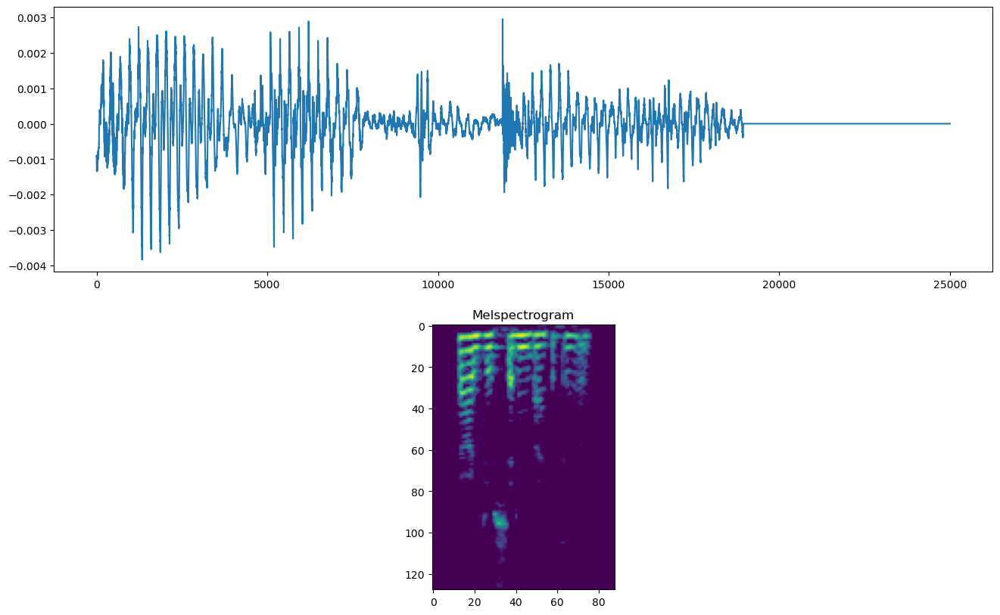

Second Lowest


Melpectogram of preprocessed audio, shape: (128, 88)


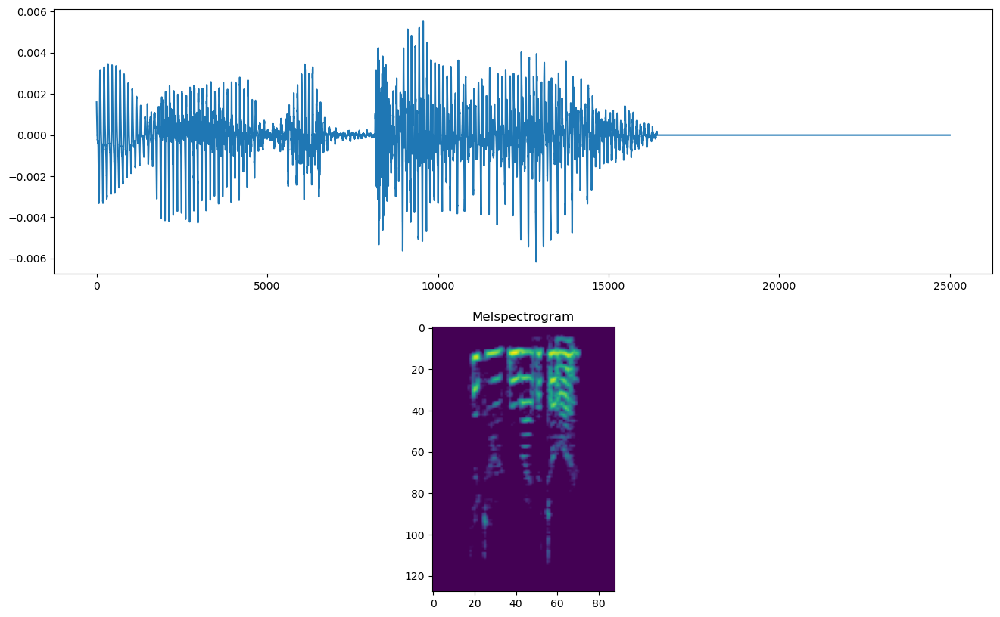

Loudest


Melpectogram of preprocessed audio, shape: (128, 88)


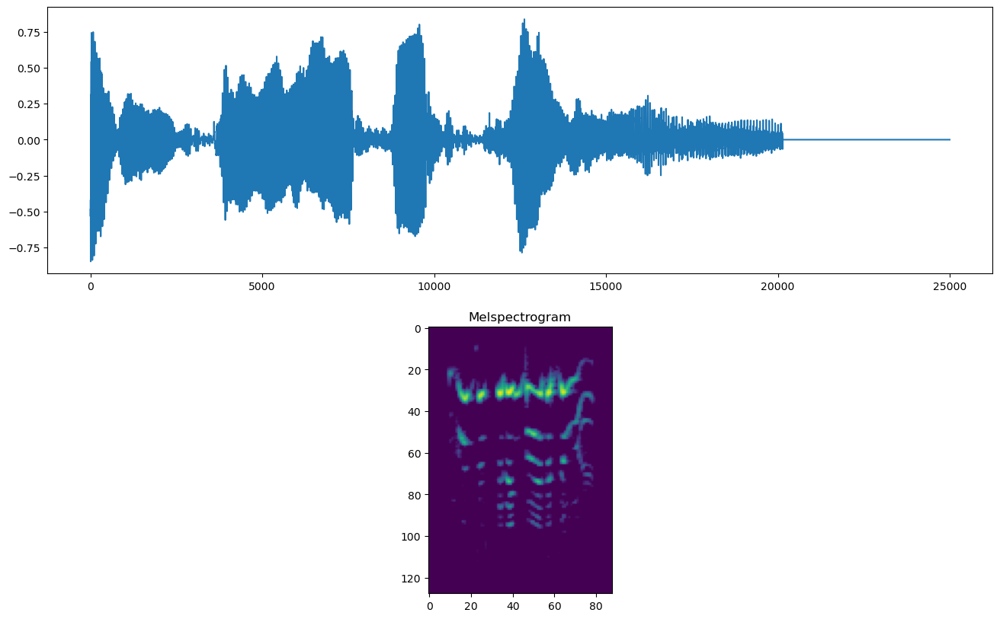

Second Loudest


Melpectogram of preprocessed audio, shape: (128, 88)


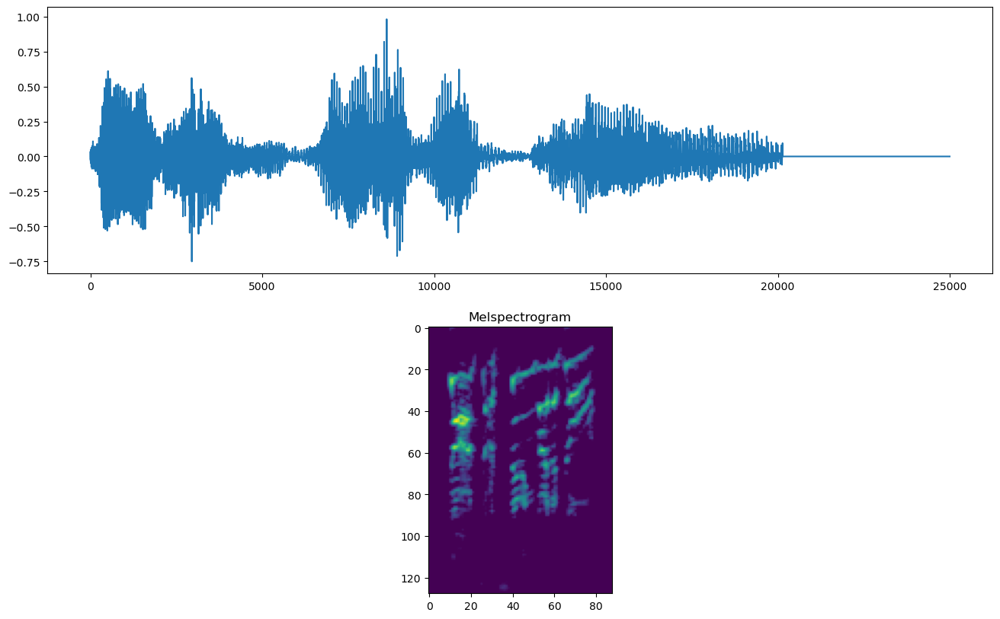

Shortest


Melpectogram of preprocessed audio, shape: (128, 88)


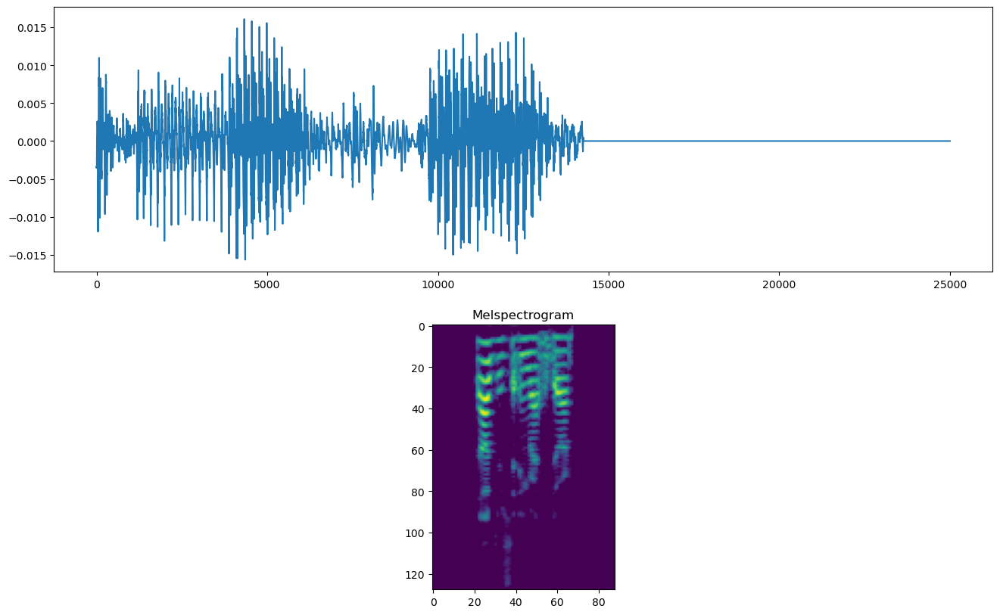

Second Shortest


Melpectogram of preprocessed audio, shape: (128, 88)


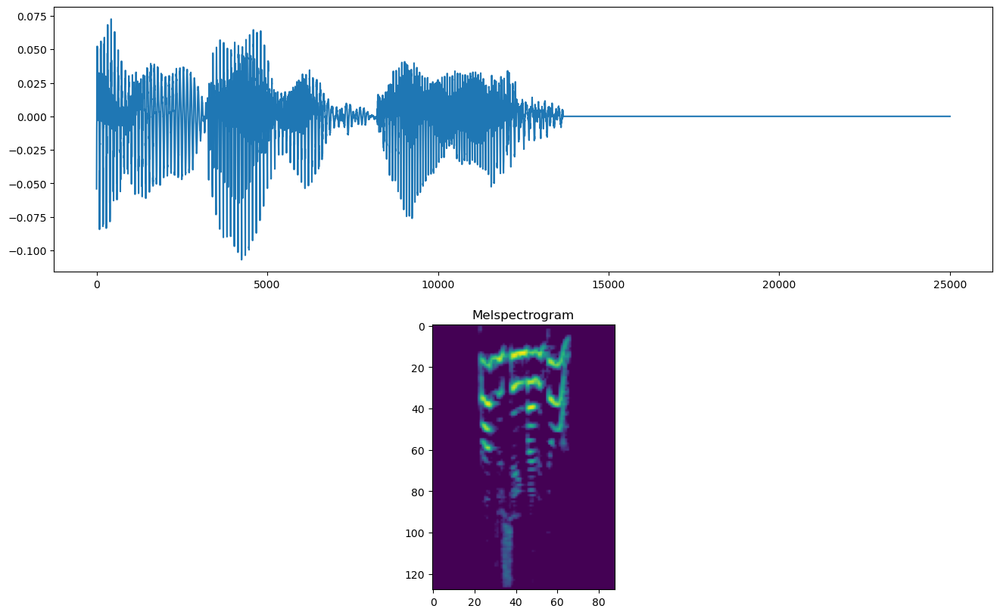

Longest


Melpectogram of preprocessed audio, shape: (128, 88)


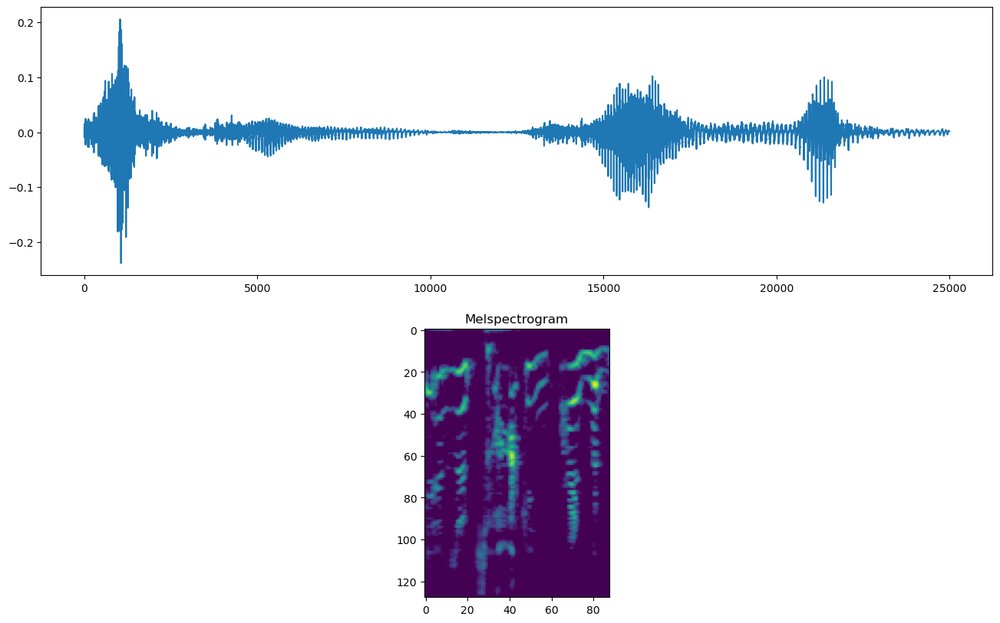

Second Longest


Melpectogram of preprocessed audio, shape: (128, 88)


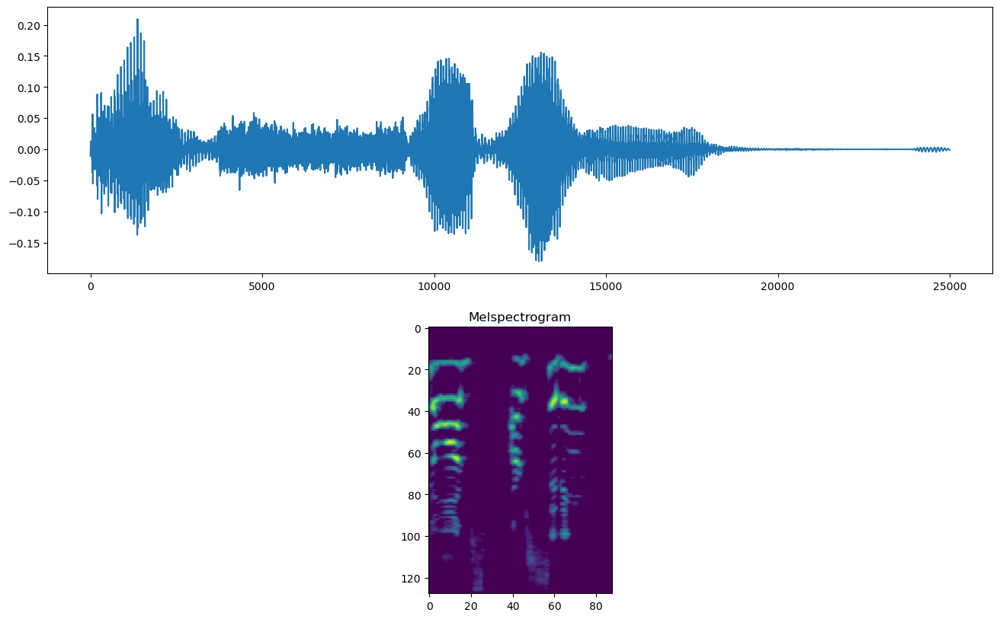

In [147]:
for key, value in files_check.items():
    print(key)
    plot_audio(value)

Random audio:
Emotion: surprised


Melpectogram of preprocessed audio, shape: (128, 88)


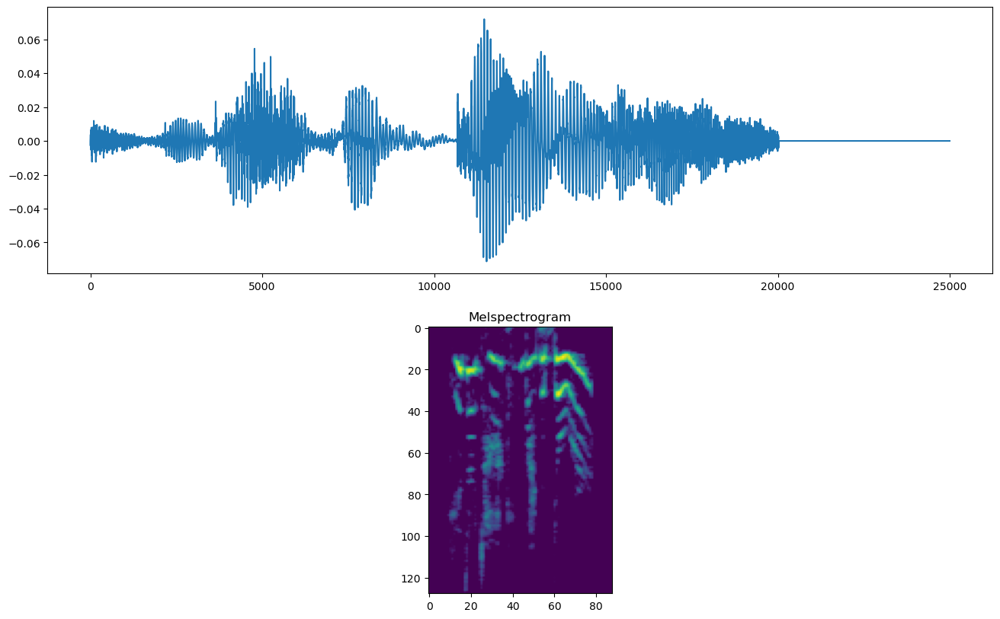

In [148]:
n_random = np.random.randint(0, len(files_details))
random = files_details.iloc[n_random]['file']
print('Random audio:')
emotion = random.split('/')[2]
print(f'Emotion: {emotion}')
plot_audio(random)

Random audio:
Emotion: angry


Melpectogram of preprocessed audio, shape: (128, 88)


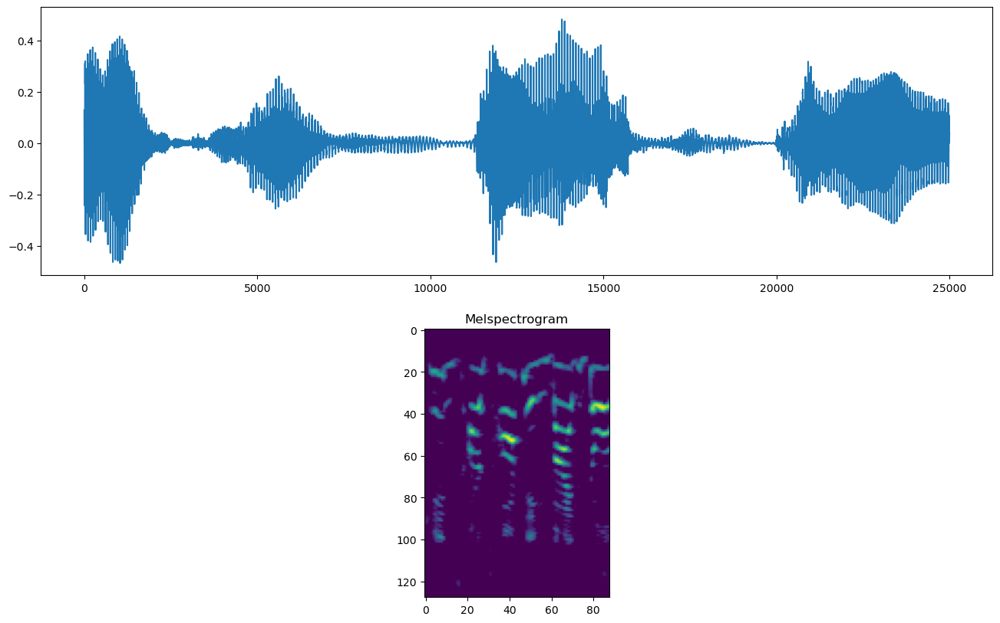

In [149]:
n_random = np.random.randint(0, len(files_details))
random = files_details.iloc[n_random]['file']
print('Random audio:')
emotion = random.split('/')[2]
print(f'Emotion: {emotion}')
plot_audio(random)

<span style="font-size: 16px;"> While a melspectrogram is not directly interpretable by humans, it provides a detailed representation of how frequency patterns change. I expect the model to learn and recognize these patterns to distinguish between the eight different emotions effectively.

## Baseline Score

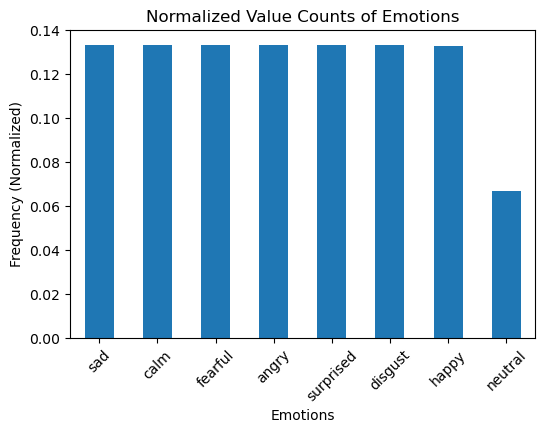

In [150]:
value_counts_normalized = files_details['emotions'].value_counts(normalize=True)

# Create a bar plot
plt.figure(figsize=(6, 4))
value_counts_normalized.plot(kind='bar')
plt.xlabel('Emotions')
plt.ylabel('Frequency (Normalized)')
plt.title('Normalized Value Counts of Emotions')
plt.xticks(rotation=45);  # Rotate x-axis labels for better visibility

> <span style="font-size: 16px;">  We can see that the target variables are not balanced in this dataset, there is no strong intensity for the 'neutral' emotion. As it is, the baseline is 13.3%. Let's see if we can make a model that surpasses this score.

# Next Steps

- <span style="font-size: 16px;">  Apply these preprocessed steps to the whole dataset and input to the convolutional neural network model
- <span style="font-size: 16px;">  Tune the model accordingly

References:
<br>
- Ketan Doshi article in Medium: https://towardsdatascience.com/audio-deep-learning-made-simple-part-1-state-of-the-art-techniques-da1d3dff2504
- Rob Mulla's Audio Processing in Python tutorial on youtube: https://youtu.be/ZqpSb5p1xQo
- Librosa Documentation